**Name:** LI XINYAN

**EID:** 55670594

# CS5489 - Tutorial 2
## Text Document Classification with Naive Bayes

In this tutorial you will classify text documents using Naive Bayes classifers.  We will be working with the dataset called "20 Newsgroups", which is a collection of 20,000 newsgroup posts organized into 20 categories.

First we need to initialize Python.  Run the below cell.

In [1]:
%matplotlib inline
import IPython.core.display         
# setup output image format (Chrome works best)
IPython.core.display.set_matplotlib_formats("svg")
import matplotlib.pyplot as plt
import matplotlib
from numpy import *
from sklearn import *
from scipy import stats, special
random.seed(100)

Next, put the file "20news-bydate_py3.pkz' into the same directory as this ipynb file. **Do not unzip the file.**

Next, we will extract 4 classes from the dataset.  Run the below cell.

In [2]:
# strip away headers/footers/quotes from the text
removeset = ('headers', 'footers', 'quotes')

# only use 4 categories
cats      = ['alt.atheism', 'talk.religion.misc', 'comp.graphics', 'sci.space']

# load the training and testing sets
newsgroups_train = datasets.fetch_20newsgroups(subset='train',
                           remove=removeset, categories=cats, data_home='./')
newsgroups_test  = datasets.fetch_20newsgroups(subset='test', 
                           remove=removeset, categories=cats, data_home='./')

Now, we check if we got all the data.  The training set should have 2034 documents, and the test set should have 1353 documents.

In [3]:
print("training set size:", len(newsgroups_train.data))
print("testing set size: ",  len(newsgroups_test.data))
print(newsgroups_train.target_names)

training set size: 2034
testing set size:  1353
['alt.atheism', 'comp.graphics', 'sci.space', 'talk.religion.misc']


Count the number examples in each class.  `newsgroups_train.target` is an array of class values (0 through 3), and `newsgroups_train.target[i]` is the class of the i-th document.

In [4]:
print("class counts")
for i in [0, 1, 2, 3]:
    print("{:20s}: {}".format(newsgroups_train.target_names[i], sum(newsgroups_train.target == i)))

class counts
alt.atheism         : 480
comp.graphics       : 584
sci.space           : 593
talk.religion.misc  : 377


Now have a look at the documents.  `newsgroups_train.data` is a list of strings, and `newsgroups_train.data[i]` is the i-th document.

In [5]:
for i in [0, 1, 2 ,3]:
    print("--- document {} (class={}) ---".format(
        i, newsgroups_train.target_names[newsgroups_train.target[i]]))
    print(newsgroups_train.data[i])

--- document 0 (class=comp.graphics) ---
Hi,

I've noticed that if you only save a model (with all your mapping planes
positioned carefully) to a .3DS file that when you reload it after restarting
3DS, they are given a default position and orientation.  But if you save
to a .PRJ file their positions/orientation are preserved.  Does anyone
know why this information is not stored in the .3DS file?  Nothing is
explicitly said in the manual about saving texture rules in the .PRJ file. 
I'd like to be able to read the texture rule information, does anyone have 
the format for the .PRJ file?

Is the .CEL file format available from somewhere?

Rych
--- document 1 (class=talk.religion.misc) ---


Seems to be, barring evidence to the contrary, that Koresh was simply
another deranged fanatic who thought it neccessary to take a whole bunch of
folks with him, children and all, to satisfy his delusional mania. Jim
Jones, circa 1993.


Nope - fruitcakes like Koresh have been demonstrating such evil 

**Tip:** while you do the tutorial, it is okay to make additional code cells in the file.  This will allow you to avoid re-running code (like training a classifier, then testing a classifier).

### 1. Build document vectors
Create the vocabulary from the training data.  Then build the document vectors for the training and testing sets.  You can decide how many words you want in the vocabulary.

In [6]:
# pull out the document data and labels
traindata = newsgroups_train.data
trainY = newsgroups_train.target

testdata = newsgroups_test.data
testY  = newsgroups_test.target

In [7]:
### INSERT YOUR CODE HERE

In [8]:
# BoW Version Test
# cntvect.vocabulary_ = 26576 when max_features is not designated
from sklearn.feature_extraction.text import CountVectorizer

cntvect = CountVectorizer(stop_words='english')
# cntvect = CountVectorizer(stop_words='english', max_features=100)
# cntvect = CountVectorizer(stop_words='english', max_features=200)

cntvect.fit(traindata)

# Notice: diff between fit_trasf() and tasf()
trainX = cntvect.fit_transform(newsgroups_train.data)
testX  = cntvect.transform(newsgroups_test.data)

print(len(cntvect.vocabulary_))
print(cntvect.vocabulary_)

26576
{'hi': 12052, 've': 25319, 'noticed': 16965, 'save': 21204, 'model': 16089, 'mapping': 15322, 'planes': 18440, 'positioned': 18701, 'carefully': 5385, '3ds': 1152, 'file': 10286, 'reload': 20239, 'restarting': 20513, 'given': 11203, 'default': 7698, 'position': 18699, 'orientation': 17464, 'prj': 19066, 'positions': 18704, 'preserved': 18949, 'does': 8554, 'know': 14154, 'information': 13023, 'stored': 22878, 'explicitly': 9848, 'said': 21084, 'manual': 15301, 'saving': 21208, 'texture': 23828, 'rules': 20977, 'like': 14706, 'able': 2408, 'read': 19841, 'rule': 20973, 'format': 10605, 'cel': 5546, 'available': 3998, 'rych': 21025, 'barring': 4219, 'evidence': 9658, 'contrary': 6827, 'koresh': 14193, 'simply': 21951, 'deranged': 7909, 'fanatic': 10078, 'thought': 23963, 'neccessary': 16622, 'bunch': 5104, 'folks': 10519, 'children': 5786, 'satisfy': 21184, 'delusional': 7808, 'mania': 15266, 'jim': 13733, 'jones': 13786, 'circa': 5886, '1993': 581, 'nope': 16916, 'fruitcakes': 107

In [9]:
print(trainX[0])

  (0, 12052)	1
  (0, 25319)	1
  (0, 16965)	1
  (0, 21204)	2
  (0, 16089)	1
  (0, 15322)	1
  (0, 18440)	1
  (0, 18701)	1
  (0, 5385)	1
  (0, 1152)	3
  (0, 10286)	6
  (0, 20239)	1
  (0, 20513)	1
  (0, 11203)	1
  (0, 7698)	1
  (0, 18699)	1
  (0, 17464)	2
  (0, 19066)	3
  (0, 18704)	1
  (0, 18949)	1
  (0, 8554)	2
  (0, 14154)	1
  (0, 13023)	2
  (0, 22878)	1
  (0, 9848)	1
  (0, 21084)	1
  (0, 15301)	1
  (0, 21208)	1
  (0, 23828)	2
  (0, 20977)	1
  (0, 14706)	1
  (0, 2408)	1
  (0, 19841)	1
  (0, 20973)	1
  (0, 10605)	2
  (0, 5546)	1
  (0, 3998)	1
  (0, 21025)	1


### 2. Bernoulli Naive Bayes 
Learn a Bernoulli Naive Bayes model from the training set.  What is the prediction accuracy on the test set?  Try different parameters (alpha, max_features, etc) to get the best performance.

In [10]:
### INSERT YOUR CODE HERE

/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/s

/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/s

/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/s

/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/s

/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/s

/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/s

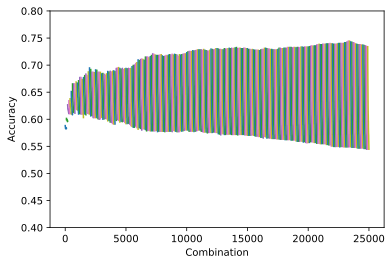

Best combination: max_features:23400.0  alpha value:0.0  accuracy:0.7442719881744272


In [11]:
import numpy as np
cross = np.array([])

N_f = 250
N_a = 100

for m_f in range(0, N_f):
    max_features = 100 + 100 * m_f
    cntvect = CountVectorizer(stop_words='english', max_features=max_features)
    
    trainX = cntvect.fit_transform(newsgroups_train.data)
    trainY = newsgroups_train.target
    testX  = cntvect.transform(newsgroups_test.data)
    testY  = newsgroups_test.target
    
    alphas = np.linspace(0, 2, N_a)
    for alp in alphas:
        
        # build model
        bmodel = naive_bayes.BernoulliNB(alpha = alp)
        bmodel.fit(trainX, trainY)
    
        # test model
        predY = bmodel.predict(testX)
    
        # calculate accuracy
        acc = metrics.accuracy_score(testY, predY)
        
        cross = np.append(cross, max_features)
        cross = np.append(cross, alp)
        cross = np.append(cross, acc)
        # print("max_features:{}  alpha value:{}  accuracy:{}".format(max_features, alp, acc))

cross = cross.reshape([N_f * N_a, 3])
color_list = ['bo-', 'go-', 'ro-', 'co-', 'mo-', 'yo-', 'ko-', 'wo-']

plt.xlabel("Combination")
plt.ylabel("Accuracy")
plt.ylim(0.4, 0.8)

for i in range(N_f):
    c = cross[:, 2][i * N_a : (i+1) * N_a]
#     print('c:', c)
    X = np.arange(i * N_a, (i+1) * N_a)
#     print('X:', X)
    plt.plot(X, c, np.random.randint(0, 8))

plt.show()

idx = np.argmax(cross[:, 2])
print("Best combination: max_features:{}  alpha value:{}  accuracy:{}".format(cross[idx, 0], cross[idx, 1], cross[idx, 2]))


In [18]:
# Use the best combination of parameters above to construct classifier
cntvect = CountVectorizer(stop_words='english', max_features = int(cross[idx, 0]))
trainX = cntvect.fit_transform(newsgroups_train.data)
testX  = cntvect.transform(newsgroups_test.data)
bmodel = naive_bayes.BernoulliNB(alpha = cross[idx, 1])
bmodel.fit(trainX, trainY)

/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)


BernoulliNB(alpha=0.0, binarize=0.0, class_prior=None, fit_prior=True)

What are the most informative words for each category?  Run the below code.

Note: `model.coef_[i]` will index the scores for the i-th class

In [19]:
# get the word names
fnames_b = asarray(cntvect.get_feature_names())
for i,c in enumerate(newsgroups_train.target_names):
    tmp = argsort(bmodel.coef_[i])[-10:]
    print("class", c)
    for t in tmp:
        print("    {:9s} ({:.5f})".format(fnames_b[t], bmodel.coef_[i][t]))

class alt.atheism
    time      (-1.80434)
    know      (-1.60944)
    does      (-1.60944)
    god       (-1.58882)
    like      (-1.54881)
    say       (-1.52940)
    just      (-1.45529)
    think     (-1.39466)
    people    (-1.29859)
    don       (-1.19018)
class comp.graphics
    just      (-1.95106)
    don       (-1.91555)
    program   (-1.88126)
    need      (-1.85904)
    does      (-1.74493)
    use       (-1.73517)
    like      (-1.60773)
    know      (-1.51009)
    graphics  (-1.49470)
    thanks    (-1.47206)
class sci.space
    earth     (-1.90786)
    use       (-1.88538)
    time      (-1.77007)
    think     (-1.73123)
    know      (-1.73123)
    nasa      (-1.73123)
    don       (-1.69385)
    just      (-1.47254)
    like      (-1.41538)
    space     (-1.01922)
class talk.religion.misc
    say       (-1.65558)
    way       (-1.62818)
    like      (-1.61476)
    does      (-1.53780)
    know      (-1.48959)
    think     (-1.42139)
    god       (-1.378

In [20]:
# Sample code from lecture: plotting the word probabilities
def plotWordProb(model):
    xr = arange(0,len(cntvect.vocabulary_))
    
    # a larger figure
    plt.figure(figsize=(16,3))
    
    plt.bar(xr+0.0, exp(model.feature_log_prob_[0,:]), width=0.4, color='b', label=newsgroups_train.target_names[0])
    plt.bar(xr+0.5, exp(model.feature_log_prob_[1,:]), width=0.4, color='r', label=newsgroups_train.target_names[1])
    plt.bar(xr+1.0, exp(model.feature_log_prob_[2,:]), width=0.4, color='g', label=newsgroups_train.target_names[2])
    plt.bar(xr+1.5, exp(model.feature_log_prob_[3,:]), width=0.4, color='y', label=newsgroups_train.target_names[3])
    
    plt.legend()
    plt.xlabel('word index'); plt.ylabel('probability of word present');
    plt.xlim(min(xr), max(xr)+1)
    
# show plot
plotWordProb(bmodel)
plt.title('probability of word present');

### 3. Multinomial Naive Bayes model
Now learn a multinomial Naive Bayes model using the TF-IDF representation for the documents.  Again try different parameter values to improve the test accuracy.

In [21]:
### INSERT YOUR CODE HERE

/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)


alpha:0.0  accuracy:0.7745750184774575
alpha:0.020202020202020204  accuracy:0.7997043606799704
alpha:0.04040404040404041  accuracy:0.7923133776792314
alpha:0.06060606060606061  accuracy:0.7908351810790836
alpha:0.08080808080808081  accuracy:0.7878787878787878
alpha:0.10101010101010102  accuracy:0.7812269031781227
alpha:0.12121212121212122  accuracy:0.7723577235772358
alpha:0.14141414141414144  accuracy:0.7738359201773836
alpha:0.16161616161616163  accuracy:0.770879526977088
alpha:0.18181818181818182  accuracy:0.7694013303769401
alpha:0.20202020202020204  accuracy:0.7694013303769401
alpha:0.22222222222222224  accuracy:0.7649667405764967
alpha:0.24242424242424243  accuracy:0.762010347376201
alpha:0.26262626262626265  accuracy:0.7605321507760532
alpha:0.2828282828282829  accuracy:0.7612712490761271
alpha:0.30303030303030304  accuracy:0.7597930524759793
alpha:0.32323232323232326  accuracy:0.7597930524759793
alpha:0.3434343434343435  accuracy:0.7575757575757576
alpha:0.36363636363636365  ac

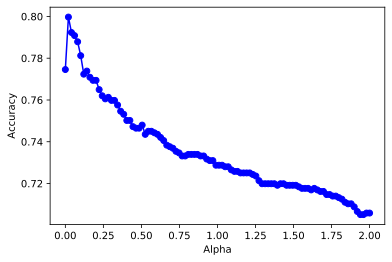

Best alpha: 0.020202020202020204 with accuracy: 0.7997043606799704


In [22]:
# Parameters of TfidfVectorizer
# 1- max_df: did not have any effects on the accuracy
# 2- ngram_range: (1, 2) for the best
# 3- 

from sklearn.feature_extraction.text import TfidfVectorizer

N_a = 100
cross = []
rng_list = [(1, 1), (1, 2), (1, 3), (1, 4), (1, 5), (2, 4)]
# for rng in rng_list:

cntvect = TfidfVectorizer(stop_words='english', ngram_range = (1, 2))
trainX = cntvect.fit_transform(newsgroups_train.data)
trainY = newsgroups_train.target
testX = cntvect.transform(newsgroups_test.data)
testY = newsgroups_test.target

alphas = np.linspace(0, 2, N_a)
for alp in alphas:
    # build model
    mmodel_tf = naive_bayes.MultinomialNB(alpha = alp)
    mmodel_tf.fit(trainX, trainY)

    # test model
    predY = mmodel_tf.predict(testX)

    # calculate accuracy
    acc = metrics.accuracy_score(testY, predY)
    cross.append(acc)
    print("alpha:{}  accuracy:{}".format(alp, acc))

plt.xlabel("Alpha")
plt.ylabel("Accuracy")
plt.plot(alphas, cross, 'bo-')
plt.show()

idx = np.argmax(cross)
print("Best alpha:", alphas[idx], 'with accuracy:', max(cross))


In [23]:
# Best model
mmodel_tf = naive_bayes.MultinomialNB(alpha = alphas[idx])
mmodel_tf.fit(trainX, trainY)

# test model
predY = mmodel_tf.predict(testX)

# calculate accuracy
acc = metrics.accuracy_score(testY, predY)
print("alpha:{}  accuracy:{}".format(alphas[idx], acc))

alpha:0.020202020202020204  accuracy:0.7997043606799704


What are the most informative features for Multinomial model? Run the below code.

In [24]:
# get the word names
fnames = asarray(cntvect.get_feature_names())
for i,c in enumerate(newsgroups_train.target_names):
#     tmp_tf = argsort(mmodel_tf.coef_[i])[-20:]
#     tmp_b = argsort(bmodel.coef_[i])[-20:]
    tmp_tf = argsort(mmodel_tf.coef_[i])[-10:]
    tmp_b = argsort(bmodel.coef_[i])[-10:]
    
    print("class", c)
    print('    TF-IDF Multinomial', '\t\t   ', 'Bernoulli')
    
    for j in range(len(tmp_tf)):
        print("    {:9s} ({:.5f})".format(fnames[tmp_tf[j]], mmodel_tf.coef_[i][tmp_tf[j]]), end = '\t')
        print("    {:9s} ({:.5f})".format(fnames_b[tmp_b[j]],bmodel.coef_[i][tmp_b[j]]))
    print()

class alt.atheism
    TF-IDF Multinomial 		    Bernoulli
    islam     (-7.51878)	    time      (-1.80434)
    does      (-7.44781)	    know      (-1.60944)
    religion  (-7.37706)	    does      (-1.60944)
    atheism   (-7.32543)	    god       (-1.58882)
    say       (-7.31573)	    like      (-1.54881)
    just      (-7.18717)	    say       (-1.52940)
    think     (-7.13712)	    just      (-1.45529)
    don       (-7.03246)	    think     (-1.39466)
    people    (-6.98173)	    people    (-1.29859)
    god       (-6.73001)	    don       (-1.19018)

class comp.graphics
    TF-IDF Multinomial 		    Bernoulli
    looking   (-7.35968)	    just      (-1.95106)
    windows   (-7.35843)	    don       (-1.91555)
    does      (-7.33744)	    program   (-1.88126)
    program   (-7.23613)	    need      (-1.85904)
    know      (-7.21040)	    does      (-1.74493)
    file      (-7.07447)	    use       (-1.73517)
    files     (-7.04974)	    like      (-1.60773)
    image     (-7.00524)	    know

How do the most informative words differ between the TF-IDF multinomial model and the Bernoulli model?

- **INSERT YOUR ANSWER HERE**

###### The key difference between TF-IDF Multinomial and the Bernoulli model: the former takes into accounts the word's apperance frequency in the whole crops, but the latter only cares about the word's apperance frequency in a specific class.

###### As a result, some words like 'don', 'just', 'think' tend to appear in all the 4 classes are treated as the more informative in a Bernoulli model, but theirs informative ranks are relatively lower in a Multinomial model:

1. Bernoulli model: I only consider a specific class and I found that these words appear frequently in this class so they're important;

2. Multinomial mode: I cosider the frequency of these words in the whole crops, and I found that these words appear frequently in all 4 clalss so they're not much important.

###### These words are actually not so meaningful, which means the TF-IDF Multinomial model can extract more informative words in order to distinguish different classes.


Finally, look at a few of the misclassified documents. 

In [25]:
### INSERT YOUR CODE HERE ###

In [26]:
# Sample codes from lecture
# prediction
testY = newsgroups_test.target
predY = mmodel_tf.predict(testX)
acc = metrics.accuracy_score(testY, predY)
print('accuracy',acc)

# misclassified items' index
print()
print('Misclassified items:')
inds = where(predY != testY)
print(inds)
print()

print('-------------------------------------------------')
for i in inds[0]:
    print("true={}, pred={}".format(newsgroups_train.target_names[testY[i]], newsgroups_train.target_names[predY[i]])) 
    print(newsgroups_test.data[i])
    print('-------------------------------------------------')

accuracy 0.7997043606799704

Misclassified items:
(array([  17,   22,   23,   30,   37,   52,   61,   62,   76,   77,   78,
         82,   86,   89,   90,   97,  105,  106,  110,  119,  122,  123,
        124,  126,  131,  132,  136,  141,  149,  150,  154,  160,  166,
        167,  171,  172,  173,  175,  177,  179,  181,  182,  185,  197,
        204,  207,  209,  211,  215,  223,  227,  234,  236,  246,  247,
        250,  257,  264,  287,  288,  289,  291,  306,  307,  311,  312,
        321,  330,  333,  334,  337,  350,  355,  357,  364,  367,  368,
        373,  374,  384,  399,  407,  415,  419,  425,  427,  432,  435,
        440,  443,  447,  453,  460,  461,  463,  465,  470,  471,  473,
        484,  492,  499,  512,  523,  530,  536,  537,  545,  548,  551,
        557,  560,  561,  564,  575,  578,  579,  594,  603,  606,  607,
        608,  617,  625,  627,  643,  645,  649,  653,  655,  656,  665,
        667,  670,  675,  682,  685,  697,  702,  706,  720,  721,  733,


Can you get any intuition or reason why they were misclassified?

- **INSERT YOUR ANSWER HERE**

###### I think: 

- First, the boundary between news groups might be fuzzy by nature. I visit the 20 Newsgroups website (http://qwone.com/~jason/20Newsgroups/). According to the introduction, some of the newsgroups are naturally related to each other, which might increase the uncertainty.

- Second, the emotions and attitudes are not fully reserved in the vocabulary; For example, class 'talk.religion.misc' and 'alt.atheism' are very likely to discuss the same topic. As a result, same words are used even though the two classes are conveying two contrary views.

- Third, some of the news are too short to convey the sufficient information for a correct classification.

### 4. Effect of smoothing
The smoothing (regularization) parameter has a big effect on the performance.  Using the Multinomial TF-IDF models, make a plot of accuracy versus different values of alpha. For each alpha, you need to train a new model. Which alpha value yields the best result?

In [27]:
### INSERT YOUR CODE HERE

/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)


alpha:0.0  accuracy:0.7745750184774575
alpha:0.005012531328320802  accuracy:0.7974870657797487
alpha:0.010025062656641603  accuracy:0.7982261640798226
alpha:0.015037593984962405  accuracy:0.7982261640798226
alpha:0.020050125313283207  accuracy:0.7997043606799704
alpha:0.02506265664160401  accuracy:0.7974870657797487
alpha:0.03007518796992481  accuracy:0.7945306725794531
alpha:0.03508771929824561  accuracy:0.7915742793791575
alpha:0.040100250626566414  accuracy:0.7923133776792314
alpha:0.045112781954887216  accuracy:0.7923133776792314
alpha:0.05012531328320802  accuracy:0.7908351810790836
alpha:0.05513784461152882  accuracy:0.7908351810790836
alpha:0.06015037593984962  accuracy:0.7908351810790836
alpha:0.06516290726817042  accuracy:0.7886178861788617
alpha:0.07017543859649122  accuracy:0.7900960827790096
alpha:0.07518796992481203  accuracy:0.7886178861788617
alpha:0.08020050125313283  accuracy:0.7878787878787878
alpha:0.08521303258145363  accuracy:0.78640059127864
alpha:0.09022556390977

alpha:0.7819548872180451  accuracy:0.7331855136733185
alpha:0.7869674185463659  accuracy:0.7331855136733185
alpha:0.7919799498746867  accuracy:0.7331855136733185
alpha:0.7969924812030075  accuracy:0.7331855136733185
alpha:0.8020050125313283  accuracy:0.7339246119733924
alpha:0.8070175438596491  accuracy:0.7339246119733924
alpha:0.8120300751879699  accuracy:0.7339246119733924
alpha:0.8170426065162907  accuracy:0.7339246119733924
alpha:0.8220551378446115  accuracy:0.7339246119733924
alpha:0.8270676691729323  accuracy:0.7339246119733924
alpha:0.8320802005012531  accuracy:0.7339246119733924
alpha:0.8370927318295739  accuracy:0.7339246119733924
alpha:0.8421052631578947  accuracy:0.7339246119733924
alpha:0.8471177944862155  accuracy:0.7339246119733924
alpha:0.8521303258145363  accuracy:0.7339246119733924
alpha:0.8571428571428571  accuracy:0.7339246119733924
alpha:0.8621553884711779  accuracy:0.7339246119733924
alpha:0.8671679197994987  accuracy:0.7339246119733924
alpha:0.8721804511278195  ac

alpha:1.5639097744360901  accuracy:0.7176644493717664
alpha:1.5689223057644108  accuracy:0.7176644493717664
alpha:1.5739348370927317  accuracy:0.7176644493717664
alpha:1.5789473684210527  accuracy:0.7176644493717664
alpha:1.5839598997493733  accuracy:0.7176644493717664
alpha:1.588972431077694  accuracy:0.7176644493717664
alpha:1.593984962406015  accuracy:0.7176644493717664
alpha:1.5989974937343359  accuracy:0.7176644493717664
alpha:1.6040100250626566  accuracy:0.7169253510716925
alpha:1.6090225563909772  accuracy:0.7169253510716925
alpha:1.6140350877192982  accuracy:0.7169253510716925
alpha:1.619047619047619  accuracy:0.7169253510716925
alpha:1.6240601503759398  accuracy:0.7169253510716925
alpha:1.6290726817042605  accuracy:0.7176644493717664
alpha:1.6340852130325814  accuracy:0.7176644493717664
alpha:1.6390977443609023  accuracy:0.7176644493717664
alpha:1.644110275689223  accuracy:0.7169253510716925
alpha:1.6491228070175437  accuracy:0.7169253510716925
alpha:1.6541353383458646  accura

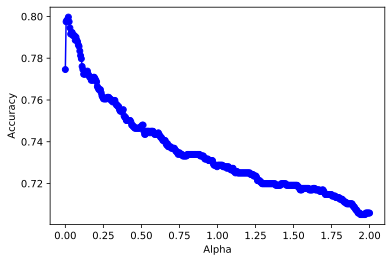

Best alpha: 0.020050125313283207 with accuracy: 0.7997043606799704


In [28]:
from sklearn.feature_extraction.text import TfidfVectorizer

N_a = 400
cross = []
rng_list = [(1, 1), (1, 2), (1, 3), (1, 4), (1, 5), (2, 4)]
# for rng in rng_list:

cntvect = TfidfVectorizer(stop_words='english', ngram_range = (1, 2))
trainX = cntvect.fit_transform(newsgroups_train.data)
trainY = newsgroups_train.target
testX = cntvect.transform(newsgroups_test.data)
testY = newsgroups_test.target

alphas = np.linspace(0, 2, N_a)
for alp in alphas:
    # build model
    mmodel_tf = naive_bayes.MultinomialNB(alpha = alp)
    mmodel_tf.fit(trainX, trainY)

    # test model
    predY = mmodel_tf.predict(testX)

    # calculate accuracy
    acc = metrics.accuracy_score(testY, predY)
    cross.append(acc)
    print("alpha:{}  accuracy:{}".format(alp, acc))

plt.xlabel("Alpha")
plt.ylabel("Accuracy")
plt.plot(alphas, cross, 'bo-')
plt.show()

idx = np.argmax(cross)
print("Best alpha:", alphas[idx], 'with accuracy:', max(cross))


### 5. Effect of vocabulary size
The vocabulary size also affects the accuracy.  Make another plot of accuracy versus vocabulary size.  Which vocabulary size yields the best result?

In [29]:
### INSERT YOUR CODE HERE

/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/site-packages/sklearn/naive_bayes.py:485: UserWarning: alpha too small will result in numeric errors, setting alpha = 1.0e-10
  'setting alpha = %.1e' % _ALPHA_MIN)
/opt/anaconda3/lib/python3.7/s

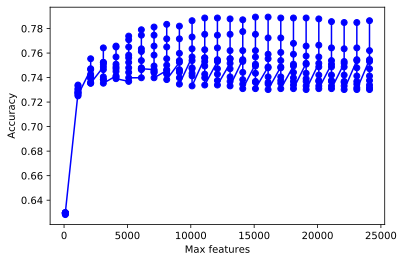

alpha:0.2222222222222222  max_features:15100  accuracy:0.7893569844789357


In [30]:
N_f = 25
N_a = 10

mxf_list = []
acc_list = []
alp_list = []

for m_f in range(0, N_f):
    mxf = 100 + 1000 * m_f
    
    cntvect = TfidfVectorizer(stop_words='english', max_features = mxf)
    trainX = cntvect.fit_transform(newsgroups_train.data)
    testX = cntvect.transform(newsgroups_test.data)
    trainY = newsgroups_train.target
    testY = newsgroups_test.target
    
    alphas = np.linspace(0, 2, N_a)
    for alp in alphas:
        # build model
        mmodel_tf = naive_bayes.MultinomialNB(alpha = alp)
        mmodel_tf.fit(trainX, trainY)

        # test model
        predY = mmodel_tf.predict(testX)

        # calculate accuracy
        acc = metrics.accuracy_score(testY, predY)
        mxf_list.append(mxf)
        alp_list.append(alp)
        acc_list.append(acc)


plt.xlabel("Max features")
plt.ylabel("Accuracy")
plt.plot(mxf_list, acc_list, 'bo-')
plt.show()

mxf = mxf_list[np.argmax(acc_list)]
alp = alp_list[np.argmax(acc_list)]

print("alpha:{}  max_features:{}  accuracy:{}".format(alp, mxf, max(acc_list)))

## 6. Poisson Naive Bayes

Now we will implement a Naive Bayes classifier using a Poisson distribution to model the count of each word appearing in the document.  Recall that the Poisson distribution is:
$$ \mathrm{Poisson}(x,\mu) = \frac{1}{x!}e^{-\mu} \mu^x$$
where $x \in \{0,1,2,\cdots\}$ is a counting number, and $\mu$ is the Poisson mean (arrival rate).

Here is some code showing how to compute the Poisson distribution using scipy.

[[ -1.          -2.          -3.5       ]
 [ -1.          -1.30685282  -2.24723703]
 [ -1.69314718  -1.30685282  -1.68762124]
 [ -2.79175947  -1.71231793  -1.53347056]
 [ -4.17805383  -2.40546511  -1.66700196]
 [ -5.78749174  -3.32175584  -2.0236769 ]
 [ -7.57925121  -4.42036813  -2.5626734 ]
 [ -9.52516136  -5.6731311   -3.25582058]
 [-11.6046029   -7.05942546  -4.08249915]
 [-13.80182748  -8.56350286  -5.02696076]
 [-16.10441257 -10.17294077  -6.07678289]
 [-18.50230785 -11.87768886  -7.22191519]
 [-20.9872145  -13.66944833  -8.45405887]
 [-23.55216385 -15.54125051  -9.76624526]
 [-26.19122118 -17.48716065 -11.15253962]
 [-28.89927138 -19.50206368 -12.60782686]
 [-31.67186011 -21.58150522 -14.12765261]
 [-34.50507345 -23.72157138 -15.70810299]
 [-37.39544521 -25.91879596 -17.34571178]
 [-40.33988419 -28.17008776 -19.03738779]]


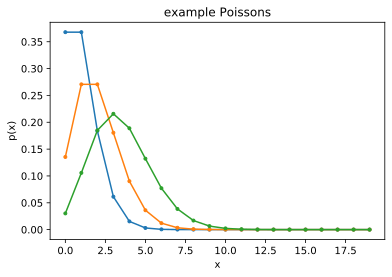

In [31]:
# Poisson distribution
from scipy.stats import poisson

# compute log Poisson(x, lambda)
px = poisson.logpmf(arange(0,20).reshape((20,1)), mu=[[1., 2., 3.5]])

# NOTE: the function respects broadcasting
# x is a column vector, and mu is a row vector
# in the output px, each column is the log Poisson values for one mu
print(px)

# make a plot
plt.title('example Poissons')
plt.plot(arange(0,20), exp(px), '.-');
plt.xlabel('x')
plt.ylabel('p(x)')
plt.show()

Now let's see how to use the Poisson to create a Naive Bayes model. Let $x_i$ be the number of times the i-th word appears in the document. Then we model $x_i$ as a Poisson distribution for each class $c$,
  $$p(x_i|y=c) = \mathrm{Poisson}(x_i, \mu_{i,c})$$
where $\mu_{i, c}$ is the Poisson parameter for the i-th word in the c-th class.  Given the data $\{x_i^{(1)}, \cdots x_i^{(N)}\}$, corresponding the counts of the i-th word in the documents in the c-th class, $\mu_{i,c}$ is estimated as the mean of the data: $\mu_{i,c} = \frac{1}{N} \sum_{n=1}^N x_i^{(n)}$.

Finally, given the document $\mathbf{x} = [x_1,\cdots,x_D]$, the document class-conditional likelihood is:
  $$ p(\mathbf{x}|y=c) = \prod_{i=1}^D p(x_i|y=c) = \prod_{i=1}^D \mathrm{Poisson}(x_i, \mu_{i,c})$$
or CCD log-likelihood is
  $$ \log p(\mathbf{x}|y=c) = \sum_{i=1}^D \log \mathrm{Poisson}(x_i, \mu_{i,c})$$

Write a class for the Poisson Naive Bayes model.  Starting with the `GaussBayes` class from lecture as the template, you only need to change the estimation of the parameters $\mu_{i,c}$ and the computation of the log CCD.

In [32]:
### INSERT YOUR CODE HERE

In [46]:
class PoissBayes:
    def __init__(self, alpha = 0.0):
        self.alpha = alpha
        
    def fit(self, X, y):
        K = max(y) + 1
        self.K = K
        
        self.mu = []
        for c in range(K):
            Xc = X[y == c]
            self.mu.append(mean(Xc, axis=0))
            
        tmp = []
        for c in range(K):
            tmp.append( count_nonzero(y==c) )
        self.pi = array(tmp) / len(y)
    
    def compute_logccd(self, X, c):
        lx = zeros((X.shape[0], 1))
        mu_list = self.mu[c]
        
        for idx in range(mu_list.shape[1]):
            if mu_list[0, idx] != 0:
                for x in range(X.shape[0]):
                    lx[x, 0] += poisson.logpmf(X[x, idx], mu = mu_list[0, idx])
        return lx

    def compute_logjoint(self, X):
        logjl = []
        for c in range(self.K):
            logjl.append(self.compute_logccd(X, c) + log(self.pi[c]))
        p = stack( logjl, axis = 1 )
        return p
            
    def predict(self, X):
        lp = self.compute_logjoint(X)
        c = argmax(lp, axis = 1)
        return c

Now test your Poisson NB model on the Newsgroup dataset.

In [47]:
### INSERT YOUR CODE HERE

In [48]:
cntvect = CountVectorizer(stop_words="english", max_features = 200)

trainX = cntvect.fit_transform(newsgroups_train.data)
testX = cntvect.transform(newsgroups_test.data)
trainY = newsgroups_train.target
testY = newsgroups_test.target
    
pmodel = PoissBayes()
pmodel.fit(trainX, trainY)

predY = pmodel.predict(testX)
acc = metrics.accuracy_score(predY, testY)
print('Accuracy:', acc)

Accuracy: 0.5306725794530672


#### BELOW JUST SOME TEST CODE

In [49]:
trainX = np.array([(1, 0, 1), (1, 0, 0), (0, 1, 0), (0, 0, 1), (2.1, 2.2, 1), (3.4, 3.4, 4), (4.2, 4.3, 3), (4.5, 4.5, 5), (4.6, 4.2, 3.9)])
trainY = np.array([1, 1, 1, 1, 1, 2, 2, 2, 2])

testX = np.array([(0.9, 1.1, 0.6), (2.2, 1.8, 1.1), (1.3, 2, 2.2), (3.5, 3.5, 4.2), (3.9, 4.3, 5.1), (4.5, 4.3, 5.2), (4.2, 3.9, 5.3)])
testY = np.array([1, 1, 1, 2, 2, 2, 2])

In [50]:
model = naive_bayes.GaussianNB()
model.fit(trainX, trainY)
predY = model.predict(testX)

print("pred: ", predY)
print("true: ", testY)
acc = metrics.accuracy_score(testY, predY)
print("accuracy=", acc)


pred:  [1 1 1 2 2 2 2]
true:  [1 1 1 2 2 2 2]
accuracy= 1.0


In [51]:
from scipy.stats import multivariate_normal as mvn 
from scipy.special import logsumexp
from numpy import *

class GaussianBayes:
    def __init__(self, alpha=0.0):
        self.alpha = alpha
        
    def fit(self, X, y):
        K = max(y)+1
        self.K = K
        
        self.mu = []
        self.Sigma = []
        for c in range(K):
            Xc = X[y==c]
            self.mu.append( mean(Xc, axis=0) )
            self.Sigma.append( cov(Xc, rowvar=False) + self.alpha*eye(len(Xc[0])) )
        
        tmp = []
        for c in range(K):
            tmp.append( count_nonzero(y==c) ) 
        self.pi = array(tmp) / len(y)
            
    def compute_logccd(self, X, c):
        lx = mvn.logpdf(X, mean=self.mu[c], cov=self.Sigma[c])
        return lx
    
    def compute_logjoint(self, X):
        jl = []
        for c in range(self.K):
            jl.append( self.compute_logccd(X, c) + log(self.pi[c]) )
        
        p = stack( jl, axis=-1 )
        return p
    
    def predict_logproba(self, X):
        lp = self.compute_logjoint(X)
        lpx = logsumexp(lp, axis=1)
        return lp - lpx[:,newaxis] 
        
    def predict_proba(self, X):
        return exp( self.predict_logproba(X) )
        
    def predict(self, X):
        lp = self.compute_logjoint(X)
        c = argmax(lp, axis=1)
        return c


In [52]:
gb = GaussianBayes()
gb.fit(trainX, trainY-1) 
print(gb.mu)
print(gb.Sigma)

[array([0.82, 0.64, 0.6 ]), array([4.175, 4.1  , 3.975])]
[array([[0.762, 0.499, 0.16 ],
       [0.499, 0.948, 0.07 ],
       [0.16 , 0.07 , 0.3  ]]), array([[0.29583333, 0.24      , 0.08583333],
       [0.24      , 0.23333333, 0.06333333],
       [0.08583333, 0.06333333, 0.66916667]])]


In [53]:
predY = gb.predict(testX)+1 

print("pred: ", predY)
print("true: ", testY)

acc = metrics.accuracy_score(testY, predY)
print("accuracy=", acc)

pred:  [1 1 1 2 2 2 2]
true:  [1 1 1 2 2 2 2]
accuracy= 1.0


How does the Poisson NB model compare with the other models that you tested?  Is this a good model for documents?

- **INSERT YOUR ANSWER HERE**

##### Poisson NB model is not as good as either the BernoulliNB model or the MultinomialNB model. I summarize the following explanations.

1. The PoissonNB (implemented above the template codes in our lecture) treats each feature independently. However, the good performance of the MultinomialNB model in NLP suggests the covariance information between words should be preserved.

2. Both the Gaussian and Multinomial distributions are continuous, but the Poisson distribution is discrete. The continuous kernel might suggest better information representation in the high-dim space, in other words, the model can catch more meaningful information.

3. Scipy lib does not provide an avaiable PoissonNB interface. During the implementation, I found that spicy's Poisson does not provide efficient operation for sparse matrix. As a result, I have to implement the complex matrix operation on my own stupid code, which is really slow when setting the max_features with a large number.
